**INTRODUCTION AND PROJECT OVERVIEW**



Sports teams and franchises go plan rigorously to put themselves in the best position to succeed when the season begins and like any other business, they can profit from the power of data and data analytics when strategizing.

As a big fan of the National Basketball Association (NBA) and an avid follower of the New Orleans Pelicans, it was tough watching my favorite team miss out on the playoffs last season. Thanks to the data provided by Tanat Metmaolee on the data science platform Kaggle, I have access to data on the statistics for all NBA players during the 2022-2023 NBA season.

The aim of this project is to leverage the data, pain points described by players and decision makers for the Pelicans and my knowledge to try and identify players who the Pelicans could target through trade or free agency in order to improve their squad.


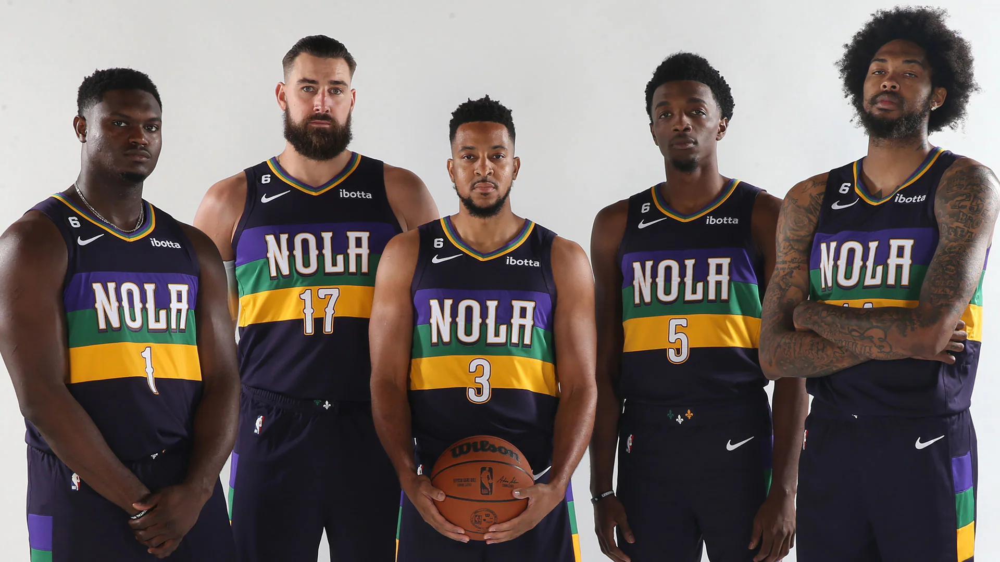

The data used for this project and its schema can be found in the link below:

https://www.kaggle.com/datasets/tanatmetmaolee/nba-player-statistics-2023

**PROJECT METHODOLOGY**

-  READING DATA AND IMPORTING LIBRARIES

-  DATA INSPECTION AND CLEANING

-  ANALYSIS
    -  Understanding team shortcomings
    
    -  Finding current players on the roster that contribute the most to the team shortcomings
    
    -  Finding players around the NBA that could help solve the teams biggest problems
    
    -  Devising a tool used to gauge player contribution to winning/team success

-  CONCLUSION AND RECOMMENDATIONS

**1. READING DATA AND IMPORTING LIBRARIES**

In [1]:
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
import seaborn as sns

In [2]:
nba_2023 = pd.read_csv("2023_nba_player_stats.csv")

**2. DATA INSPECTION AND CLEANING**

In [3]:
print(nba_2023.head())
print(nba_2023.shape)

                    Player POS Team   Age    GP     W     L     Min     PTS  \
0             Jayson Tatum  SF  BOS  25.0  74.0  52.0  22.0  2732.2  2225.0   
1              Joel Embiid   C  PHI  29.0  66.0  43.0  23.0  2284.1  2183.0   
2              Luka Doncic  PG  DAL  24.0  66.0  33.0  33.0  2390.5  2138.0   
3  Shai Gilgeous-Alexander  PG  OKC  24.0  68.0  33.0  35.0  2416.0  2135.0   
4    Giannis Antetokounmpo  PF  MIL  28.0  63.0  47.0  16.0  2023.6  1959.0   

     FGM  ...    REB    AST    TOV    STL    BLK     PF      FP   DD2   TD3  \
0  727.0  ...  649.0  342.0  213.0   78.0   51.0  160.0  3691.0  31.0   1.0   
1  728.0  ...  670.0  274.0  226.0   66.0  112.0  205.0  3706.0  39.0   1.0   
2  719.0  ...  569.0  529.0  236.0   90.0   33.0  166.0  3747.0  36.0  10.0   
3  704.0  ...  329.0  371.0  192.0  112.0   65.0  192.0  3425.0   3.0   0.0   
4  707.0  ...  742.0  359.0  246.0   52.0   51.0  197.0  3451.0  46.0   6.0   

     +/-  
0  470.0  
1  424.0  
2  128.0  
3  149

In [4]:
nba_2023.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 539 entries, 0 to 538
Data columns (total 30 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   Player  539 non-null    object 
 1   POS     534 non-null    object 
 2   Team    539 non-null    object 
 3   Age     539 non-null    float64
 4   GP      539 non-null    float64
 5   W       539 non-null    float64
 6   L       539 non-null    float64
 7   Min     539 non-null    float64
 8   PTS     539 non-null    float64
 9   FGM     539 non-null    float64
 10  FGA     539 non-null    float64
 11  FG%     539 non-null    float64
 12  3PM     539 non-null    float64
 13  3PA     539 non-null    float64
 14  3P%     539 non-null    float64
 15  FTM     539 non-null    float64
 16  FTA     539 non-null    float64
 17  FT%     539 non-null    float64
 18  OREB    539 non-null    float64
 19  DREB    539 non-null    float64
 20  REB     539 non-null    float64
 21  AST     539 non-null    float64
 22  TO

In [5]:
nba_2023.describe(include="all")

,Player,POS,Team,Age,GP,W,L,Min,PTS,FGM,...,REB,AST,TOV,STL,BLK,PF,FP,DD2,TD3,+/-
count,539,534,539,539.000000,539.000000,539.000000,539.000000,539.000000,539.000000,539.000000,...,539.000000,539.000000,539.000000,539.000000,539.000000,539.000000,539.000000,539.000000,539.000000,539.000000
unique,539,7,30,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,Jayson Tatum,SG,DAL,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,1,96,21,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,NaN,NaN,NaN,25.970315,48.040816,24.018553,24.022263,1103.617625,523.426716,191.576994,...,198.254174,115.545455,61.300557,33.270872,21.241187,91.181818,1036.938776,4.011132,0.220779,0.000000
std,NaN,NaN,NaN,4.315513,24.650686,14.496366,13.445866,827.765114,498.084360,178.351286,...,181.819962,129.578453,58.279185,28.336745,26.529238,66.206731,894.081896,8.770932,1.564432,148.223909
min,NaN,NaN,NaN,19.000000,1.000000,0.000000,0.000000,1.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-1.000000,0.000000,0.000000,-642.000000
25%,NaN,NaN,NaN,23.000000,30.500000,12.000000,14.000000,329.000000,120.500000,45.500000,...,50.500000,22.000000,14.500000,8.500000,5.000000,32.000000,254.000000,0.000000,0.000000,-70.000000
50%,NaN,NaN,NaN,25.000000,54.000000,25.000000,25.000000,970.200000,374.000000,138.000000,...,159.000000,69.000000,44.000000,28.000000,13.000000,86.000000,810.000000,0.000000,0.000000,-7.000000
75%,NaN,NaN,NaN,29.000000,68.000000,36.000000,34.000000,1845.900000,769.500000,283.500000,...,286.000000,162.500000,92.500000,51.000000,28.000000,140.000000,1646.000000,3.000000,0.000000,57.000000


The data appears to be pretty clean, there aren't any columns with missing values but for the purpose of the project, I will convert most of the columns (e.g pts, ast, reb, tov etc.) such that these columns contain the "per game" values and not the total ammassed over the course of the season.

In [6]:
per_game_columns = ["Min",
                   "PTS",
                   "FGM",
                   "FGA",
                   "3PM",
                   "3PA",
                   "FTM",
                   "FTA",
                   "OREB",
                   "DREB",
                   "REB",
                   "AST",
                   "TOV",
                   "STL",
                   "BLK",
                   "PF"]

def per_game_converter(column_1, column_2):
    return round(column_1/column_2, 2)
    


for column in per_game_columns:
    nba_2023[column] = nba_2023.apply(lambda row: per_game_converter(row[column], row["GP"]), axis=1)

nba_2023.head()

,Player,POS,Team,Age,GP,W,L,Min,PTS,FGM,...,REB,AST,TOV,STL,BLK,PF,FP,DD2,TD3,+/-
0,Jayson Tatum,SF,BOS,25.0,74.0,52.0,22.0,36.92,30.07,9.82,...,8.77,4.62,2.88,1.05,0.69,2.16,3691.0,31.0,1.0,470.0
1,Joel Embiid,C,PHI,29.0,66.0,43.0,23.0,34.61,33.08,11.03,...,10.15,4.15,3.42,1.00,1.70,3.11,3706.0,39.0,1.0,424.0
2,Luka Doncic,PG,DAL,24.0,66.0,33.0,33.0,36.22,32.39,10.89,...,8.62,8.02,3.58,1.36,0.50,2.52,3747.0,36.0,10.0,128.0
3,Shai Gilgeous-Alexander,PG,OKC,24.0,68.0,33.0,35.0,35.53,31.40,10.35,...,4.84,5.46,2.82,1.65,0.96,2.82,3425.0,3.0,0.0,149.0
4,Giannis Antetokounmpo,PF,MIL,28.0,63.0,47.0,16.0,32.12,31.10,11.22,...,11.78,5.70,3.90,0.83,0.81,3.13,3451.0,46.0,6.0,341.0


Now that the values in those columns have been converted to reflect the players per game values, the next step will involve renaming these columns to reflect the changes made.

In [7]:
column_dict = {"Min": "MPG",
               "PTS": "PPG",
               "FGM": "FGM_PG",
               "FGA": "FGA_PG",
               "3PM": "3PM_PG",
               "3PA": "3PA_PG",
               "FTM": "FTM_PG",
               "FTA": "FTA_PG",
              "OREB": "OREB_PG",
              "DREB": "DREB_PG",
               "REB": "RPG",
               "AST": "APG",
               "TOV": "TPG",
               "STL": "SPG",
               "BLK": "BPG",
                "PF": "PF_PG",
                "+/-": "plus_minus"}

nba_2023 = nba_2023.rename(column_dict, axis=1)
nba_2023.head()

,Player,POS,Team,Age,GP,W,L,MPG,PPG,FGM_PG,...,RPG,APG,TPG,SPG,BPG,PF_PG,FP,DD2,TD3,plus_minus
0,Jayson Tatum,SF,BOS,25.0,74.0,52.0,22.0,36.92,30.07,9.82,...,8.77,4.62,2.88,1.05,0.69,2.16,3691.0,31.0,1.0,470.0
1,Joel Embiid,C,PHI,29.0,66.0,43.0,23.0,34.61,33.08,11.03,...,10.15,4.15,3.42,1.00,1.70,3.11,3706.0,39.0,1.0,424.0
2,Luka Doncic,PG,DAL,24.0,66.0,33.0,33.0,36.22,32.39,10.89,...,8.62,8.02,3.58,1.36,0.50,2.52,3747.0,36.0,10.0,128.0
3,Shai Gilgeous-Alexander,PG,OKC,24.0,68.0,33.0,35.0,35.53,31.40,10.35,...,4.84,5.46,2.82,1.65,0.96,2.82,3425.0,3.0,0.0,149.0
4,Giannis Antetokounmpo,PF,MIL,28.0,63.0,47.0,16.0,32.12,31.10,11.22,...,11.78,5.70,3.90,0.83,0.81,3.13,3451.0,46.0,6.0,341.0


Given the trades that occur during the nba season, there will be rows in the data with the duplicates for player name and position but I want to make sure that there aren't any duplicates for player name and team.

In [8]:
series = ["Player", "Team"]
nba_2023.duplicated(series).value_counts()

False    539
dtype: int64

As seen, there aren't any duplicates for player name and teams, but it is important to investigate how traded players were recorded in the dataset.

In [9]:
nba_2023["Player"].value_counts().sort_values(ascending=False)

Jayson Tatum               1
Nikola Jokic               1
Shai Gilgeous-Alexander    1
Giannis Antetokounmpo      1
Anthony Edwards            1
                          ..
Alondes Williams           1
Deonte Burton              1
Frank Jackson              1
Michael Foster Jr.         1
Sterling Brown             1
Name: Player, Length: 539, dtype: int64

The code above shows that traded players were only assigned to one team and did not have their stats split into the teams they represented over the course of the season. To confirm this, I will look into a player called "Josh Richardson" who the Pelicans traded for mid-season.

In [10]:
nba_2023[nba_2023["Player"] == "Josh Richardson"]

,Player,POS,Team,Age,GP,W,L,MPG,PPG,FGM_PG,...,RPG,APG,TPG,SPG,BPG,PF_PG,FP,DD2,TD3,plus_minus
172,Josh Richardson,SG,NOP,29.0,65.0,24.0,41.0,23.53,10.06,3.68,...,2.69,2.68,1.32,1.06,0.31,1.8,1306.0,1.0,0.0,-161.0


It appears that traded players were assigned to their most recent team and did not have their stats split up. 

The data was relatively clean and this means that I have not had a lot of cleaning/preparation to perform before commencing analysis. Therefore, this is the end of this section and I will move on to the analysis part of the project.

**3.ANALYSIS**

**Understanding the shortcomings of the New Orleans Pelicans as a team**

From following the Pelicans games all through the season, the eye test showed that the team lacked 3 point shooting, rim protection (Shot blocker) and was inconsistent with its rebounding. 

In a press conference during the offseason, the Executive VP of the Pelicans said that the team was looking or "Rim protection and shooting" during the offseason. This quote can be found in the article linked below:

https://www.si.com/nba/pelicans/basketball/pelicans-must-improve-interior-defense-to-be-successful

Now, it is time to see if the data supports the eye test and the statement made by Pelicans Executive VP.

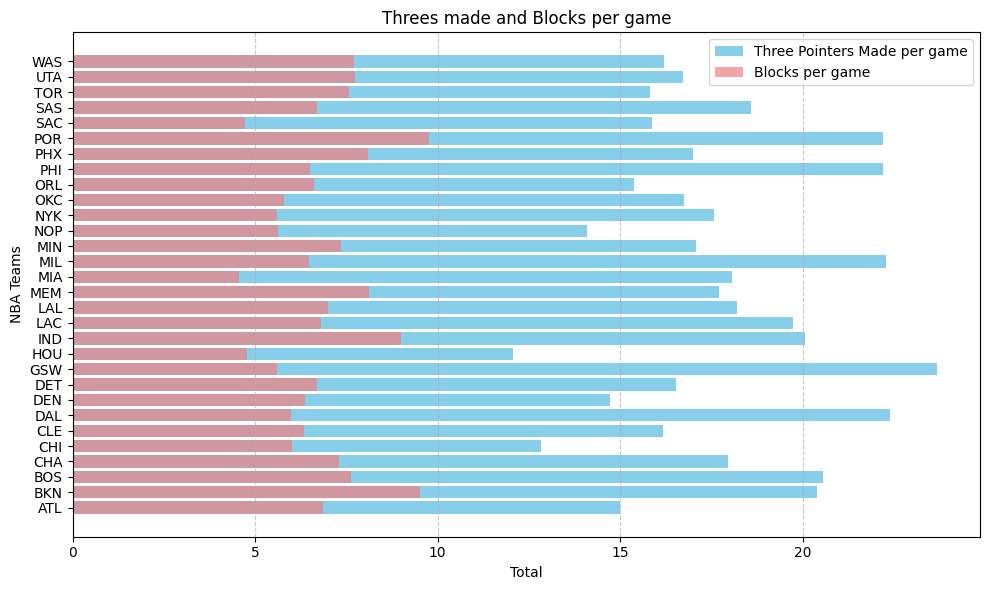

In [11]:
# Grouping the data by team and then analyzing 3 point makes per team and blocks per team

grouped = nba_2023.groupby("Team").agg({"3PM_PG": np.sum, "BPG": np.sum}).reset_index()

# Creating a horizontal bar chart to visualize results
plt.figure(figsize=(10,6))

plt.barh(grouped["Team"], grouped["3PM_PG"], label="Three Pointers Made per game", color="skyblue")
plt.barh(grouped["Team"], grouped["BPG"], label="Blocks per game", color="lightcoral", alpha=0.7)
plt.xlabel("Total")
plt.ylabel("NBA Teams")
plt.title("Threes made and Blocks per game")
plt.legend()
plt.grid(axis="x", linestyle="--", alpha=0.7)
plt.tight_layout()

plt.show()

The visual above validates the remarks made by Pelicans EVP David Griffin, the New Orleans Pelicans (NOP) ranked bottom 5 in the league for both BPG and 3PM_PG.

These are clearly variables hindering them from becoming a more successful team. But perharps there are other variables too. The next variables I will analyze are:

- Rebounding
- Assist to turnover ratio
- Personal Fouls 
- Free throw shooting

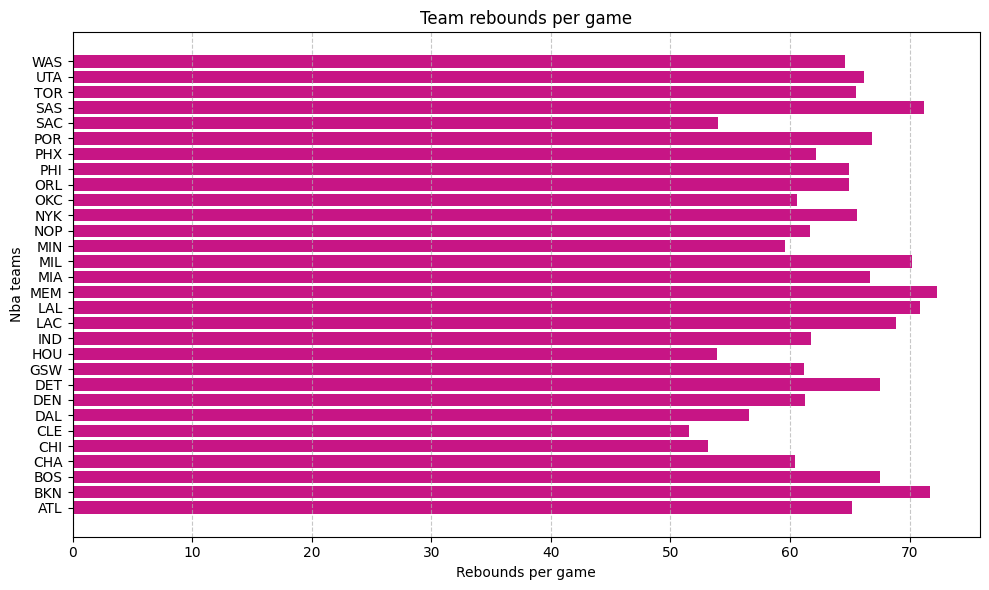

In [12]:
# TEAM REBOUNDING

grouped_reb = nba_2023.groupby("Team").agg({"RPG": np.sum}).reset_index()

# Visualizing the results
plt.figure(figsize=(10,6))

plt.barh(grouped_reb["Team"], grouped_reb["RPG"], color="mediumvioletred")
plt.xlabel("Rebounds per game")
plt.ylabel("Nba teams")
plt.title("Team rebounds per game")
plt.grid(axis="x", linestyle="--", alpha=0.7)
plt.tight_layout()

plt.show()

The visual above shows that the Pelicans were also a below average rebounding team, ranking in the bottom 10 for the past season.

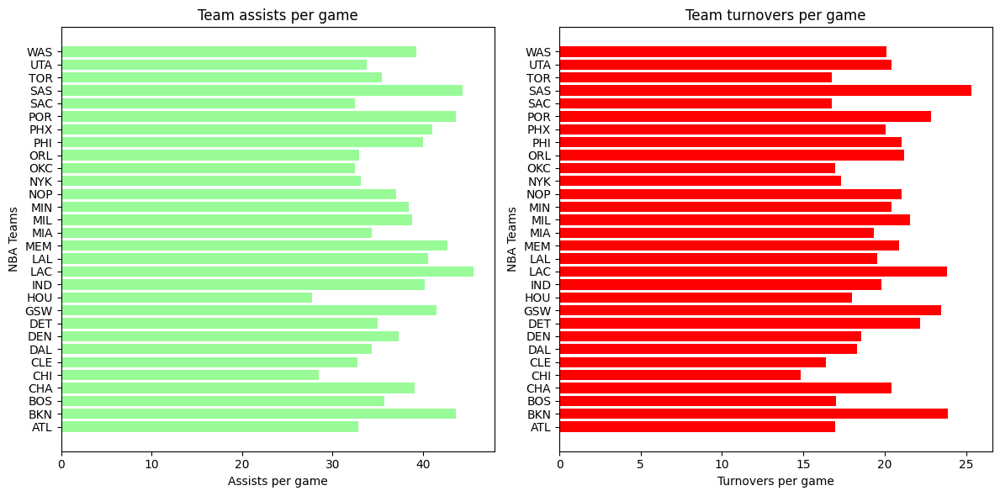

In [13]:
# Assist to turnover ratio

grouped_ast_tov = nba_2023.groupby("Team").agg({"APG": np.sum, "TPG": np.sum}).reset_index()

# Creating plots to visualize this 
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))

ax1.barh(grouped_ast_tov["Team"], grouped_ast_tov["APG"], color="palegreen")
ax1.set_xlabel("Assists per game")
ax1.set_ylabel("NBA Teams")
ax1.set_title("Team assists per game")

ax2.barh(grouped_ast_tov["Team"], grouped_ast_tov["TPG"], color="red")
ax2.set_xlabel("Turnovers per game")
ax2.set_ylabel("NBA Teams")
ax2.set_title("Team turnovers per game")

plt.tight_layout()
plt.show()

Although the Pelicans do a great job sharing the ball and getting assists, they are barely escape the bottom 10 for turnovers per game.

It might be worth it to investigate which pelican players contribute the most to the team assist total and the turnover totals. This may signal a team need for a "true" point guard.

In [14]:
# Investigating assists and turnovers on the pelicans roster.

pelicans = nba_2023[nba_2023["Team"]=="NOP"]
pelicans["assist_tov_ratio"] = round((pelicans["APG"]/pelicans["TPG"]), 2)
a_tov_rank = pelicans.sort_values(by="assist_tov_ratio", ascending=False).reset_index(drop=True)
a_tov_rank

C:\Users\Kelechi\AppData\Local\Temp\ipykernel_2332\904499484.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  pelicans["assist_tov_ratio"] = round((pelicans["APG"]/pelicans["TPG"]), 2)


,Player,POS,Team,Age,GP,W,L,MPG,PPG,FGM_PG,...,APG,TPG,SPG,BPG,PF_PG,FP,DD2,TD3,plus_minus,assist_tov_ratio
0,Garrett Temple,SF,NOP,36.0,25.0,16.0,9.0,6.47,2.00,0.72,...,0.52,0.16,0.36,0.08,0.60,119.0,0.0,0.0,-17.0,3.25
1,Larry Nance Jr.,PF,NOP,30.0,65.0,34.0,31.0,21.24,6.78,2.86,...,1.83,0.65,0.86,0.57,2.05,1281.0,3.0,0.0,185.0,2.82
2,CJ McCollum,SG,NOP,31.0,75.0,38.0,37.0,35.32,20.91,7.83,...,5.72,2.44,0.93,0.51,2.04,2746.0,6.0,0.0,59.0,2.34
3,Dyson Daniels,G,NOP,20.0,59.0,33.0,26.0,17.66,3.85,1.47,...,2.27,0.97,0.73,0.19,1.68,759.0,0.0,0.0,-7.0,2.34
4,Kira Lewis Jr.,PG,NOP,22.0,25.0,11.0,14.0,9.39,4.56,1.60,...,0.92,0.40,0.40,0.08,0.96,214.0,0.0,0.0,62.0,2.30
5,Jose Alvarado,PG,NOP,25.0,61.0,30.0,31.0,21.48,9.02,3.30,...,3.05,1.33,1.10,0.16,2.05,1148.0,0.0,0.0,103.0,2.29
6,Josh Richardson,SG,NOP,29.0,65.0,24.0,41.0,23.53,10.06,3.68,...,2.68,1.32,1.06,0.31,1.80,1306.0,1.0,0.0,-161.0,2.03
7,Naji Marshall,SF,NOP,25.0,77.0,40.0,37.0,23.27,9.06,3.21,...,2.45,1.26,0.70,0.18,1.47,1423.0,0.0,0.0,6.0,1.94
8,Trey Murphy III,SG,NOP,22.0,79.0,39.0,40.0,30.99,14.53,4.90,...,1.42,0.77,1.13,0.54,1.96,1988.0,1.0,0.0,38.0,1.84
9,Herbert Jones,SF,NOP,24.0,66.0,31.0,35.0,29.55,9.83,3.56,...,2.45,1.33,1.56,0.64,3.15,1562.0,0.0,0.0,150.0,1.84


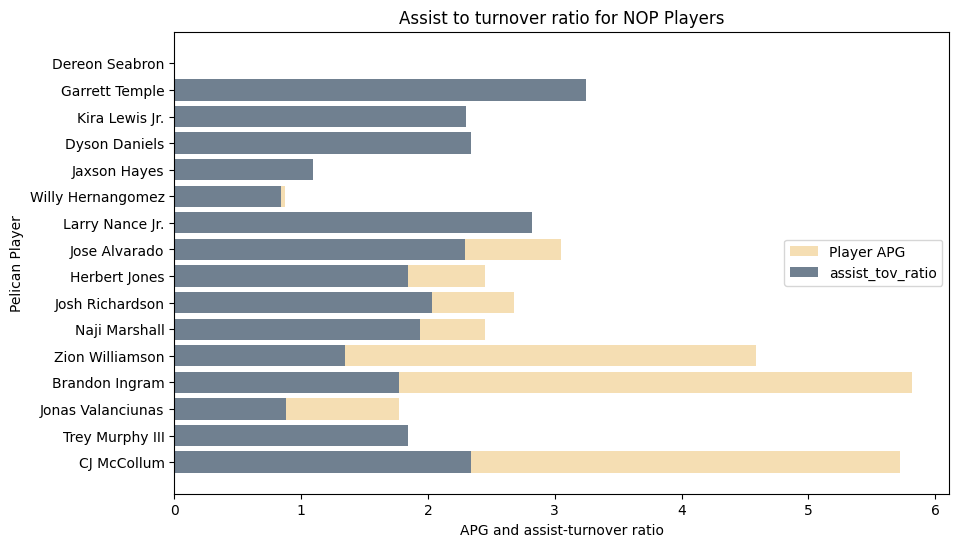

In [15]:
# Visualizing assist leaders and their assist to turnover ratio

fig, ax = plt.subplots(figsize=(10,6))

ax.barh(pelicans["Player"], pelicans["APG"], color="wheat", label="Player APG")
ax.barh(pelicans["Player"], pelicans["assist_tov_ratio"], color="slategray", label="assist_tov_ratio")
ax.set_xlabel("APG and assist-turnover ratio")
ax.set_ylabel("Pelican Player")
ax.set_title("Assist to turnover ratio for NOP Players")

ax.legend()
plt.show()

Although Brandon Ingram is the team leader in Assists per game, he turns the ball over at a very high rate which reduces his assists to turnover ratio.

Players like CJ McCollum, Larry Nance Jr., Garret Temple, Dyson Daniels and Naji Marshall all have good assist to turnover ratio but some of the players like Temple and Lewis score high in this perhaps due to their smaller sample size (i.e lack of minutes).

Factoring minutes in, it may be more beneficial for the team to give CJ McCollum more responsibilities as the primary ball handler. Possessions are very valuable and must be maximized to give the team the best chance of winning.

Dyson Daniels may also benefit from seeeing an increase in responsibility.

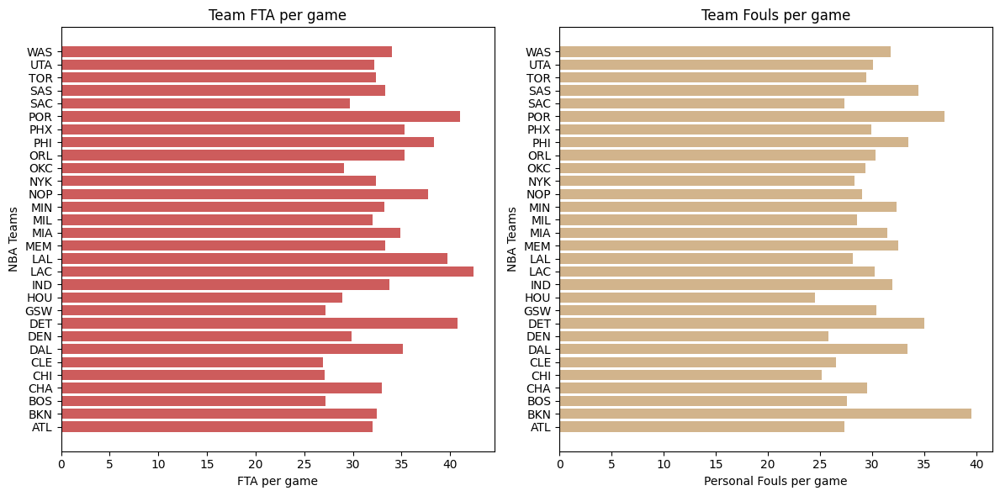

In [16]:
# Free throw attempts and fouls committed per game

grouped_fta_pf = nba_2023.groupby("Team").agg({"FTA_PG": np.sum, "PF_PG": np.sum}).reset_index()

# Creating plots to visualize this 
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))

ax1.barh(grouped_fta_pf["Team"], grouped_fta_pf["FTA_PG"], color="indianred")
ax1.set_xlabel("FTA per game")
ax1.set_ylabel("NBA Teams")
ax1.set_title("Team FTA per game")

ax2.barh(grouped_fta_pf["Team"], grouped_fta_pf["PF_PG"], color="tan")
ax2.set_xlabel("Personal Fouls per game")
ax2.set_ylabel("NBA Teams")
ax2.set_title("Team Fouls per game")

plt.tight_layout()
plt.show()

As seen in the visuals above, the Pelicans can be considered elite in terms of Free Throws attempted per game. The pelicans do a good job limiting personal fouls committed per game and they can be considered an above average team in this regard.

Now that I have a firm grasp of the teams shortcomings from the previous season as listed below:
- Three point shooting
- Rebounding
- Turnovers 
- Shot blocking

I will now investigate which Pelicans players struggle the most in these categories.

**PLAYERS WHO CONTRIBUTED THE MOST TO TEAM SHORTCOMINGS**

In previous cells, I already created a dataframe for New Orleans Pelicans Players only titled "pelicans". This dataframe is what I will work with in this section.

To begin with, I will analyze the players 3 point shooting percentage and also their attempts per game and rank them on their accuracy.

In [17]:
# Three point shooting

three_point_ranking = pelicans.sort_values(by="3P%", ascending=False).reset_index(drop=True)
three_point_ranking["Rank"]=three_point_ranking.index + 1
three_point_ranking[["Rank", "Player", "3P%", "3PA_PG"]]

,Rank,Player,3P%,3PA_PG
0,1,Kira Lewis Jr.,44.1,1.36
1,2,Garrett Temple,42.3,1.04
2,3,Trey Murphy III,40.6,6.29
3,4,Brandon Ingram,39.0,3.64
4,5,CJ McCollum,38.9,7.24
5,6,Zion Williamson,36.8,0.66
6,7,Josh Richardson,36.5,4.51
7,8,Jonas Valanciunas,34.9,1.38
8,9,Jose Alvarado,33.6,4.05
9,10,Herbert Jones,33.5,2.53


The table above shows that Kira Lewis Jr. is the Pelican's best outside threat but giving the small sample size of minutes, games played and 3 pointers attempted, it is reasonable to disregard their statistics.

CJ McCollum, Trey Murphy and Brandon Ingram can be considered the three best 3 point shooters on the team. On the other end of the spectrum, the following players have hurt the team the most with their 3 point shooting.

- Naji Marshall
- Herbert Jones 
- Jose Alvarado 
- Dyson Daniels


Next up, I will investigate the rebounding ability of Pelican players. Rebounding ability is subjective given that there are multiple factors such as Height, Weight, Minutes and Player position that makes a player a "Good rebounder".

For this project, I will create a new column in the pelicans data called rebounding rate which can be found by dividing a players rebounds per game by his minutes per game. This will give an idea of how active a player is on the rebounding glass.

It is worth noting that Centers (C) and Forwards (PF, SF) are typically the best rebounders on a roster.

In [18]:
# Rebounding

pelicans["reb_rate"] = round((pelicans["RPG"]/pelicans["MPG"]), 2)
pelicans["turnover_rate"] = round((pelicans["TPG"]/pelicans["MPG"]), 2)
pelicans["block_rate"] = round((pelicans["BPG"]/pelicans["MPG"]), 2)


reb_ranking = pelicans.sort_values(by="reb_rate", ascending=False).reset_index(drop=True)
reb_ranking["Rank"] = reb_ranking.index + 1

reb_ranking[["Rank", "Player", "RPG", "reb_rate", "MPG", "POS"]]

C:\Users\Kelechi\AppData\Local\Temp\ipykernel_2332\3548392475.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  pelicans["reb_rate"] = round((pelicans["RPG"]/pelicans["MPG"]), 2)
C:\Users\Kelechi\AppData\Local\Temp\ipykernel_2332\3548392475.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  pelicans["turnover_rate"] = round((pelicans["TPG"]/pelicans["MPG"]), 2)
C:\Users\Kelechi\AppData\Local\Temp\ipykernel_2332\3548392475.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice fro

,Rank,Player,RPG,reb_rate,MPG,POS
0,1,Jonas Valanciunas,10.18,0.41,24.91,C
1,2,Willy Hernangomez,4.74,0.39,12.04,C
2,3,Larry Nance Jr.,5.45,0.26,21.24,PF
3,4,Jaxson Hayes,2.81,0.22,12.98,C
4,5,Zion Williamson,6.97,0.21,32.97,PF
5,6,Dyson Daniels,3.19,0.18,17.66,G
6,7,Brandon Ingram,5.47,0.16,34.18,SF
7,8,Naji Marshall,3.62,0.16,23.27,SF
8,9,Herbert Jones,4.08,0.14,29.55,SF
9,10,Kira Lewis Jr.,1.32,0.14,9.39,PG


As expected, the "Big Men" (PF's and C's) dominate team rebounding. Jonas Valanciunas and Willy Hernangomez are prolific rebounders and the team could improve its chances of winning by giving them more minutes if they were looking for an internal solution. 

Although the rebounding rate shows that Jose Alvarado, Josh Richardosn, Trey Murphy III and CJ McCollum are poor rebounders, all of these players are guards and CJ McCollum actually averaged 4.37 rebounds per game. This is perhaps an indication that this metric is not very sound.

The best approach would be to compare the players rebounding rate with the league average. The same applies for turnovers and shot blocking.

In [19]:
# Filtering data to exclude players who played less than 10 MPG

filtered_nba = nba_2023[nba_2023["MPG"] >= 10.0]

print(filtered_nba.sample(10))

# Adding reb_rate to the filtered df
filtered_nba["reb_rate"] = round((filtered_nba["RPG"]/filtered_nba["MPG"]), 2)
filtered_nba["turnover_rate"] = round((filtered_nba["TPG"]/filtered_nba["MPG"]), 2)
filtered_nba["block_rate"] = round((filtered_nba["BPG"]/filtered_nba["MPG"]), 2)

# Getting league averages
avg_reb_rate = filtered_nba["reb_rate"].mean()
avg_turnover_rate = filtered_nba["turnover_rate"].mean()
avg_block_rate = filtered_nba["block_rate"].mean()

                Player POS Team   Age    GP     W     L    MPG    PPG  FGM_PG  \
20       Stephen Curry  PG  GSW  35.0  56.0  30.0  26.0  34.66  29.43    9.98   
179   Keita Bates-Diop  SF  SAS  27.0  67.0  18.0  49.0  21.68   9.66    3.52   
445  Lindell Wigginton   G  MIL  25.0   7.0   4.0   3.0  12.39   7.14    2.57   
479          Gabe York   G  IND  29.0   3.0   1.0   2.0  18.60   8.00    2.67   
397       Max Christie   G  LAL  20.0  41.0  19.0  22.0  12.50   3.12    1.07   
22        Kyrie Irving  PG  DAL  31.0  60.0  32.0  28.0  37.34  27.05    9.90   
16        Nikola Jokic   C  DEN  28.0  69.0  48.0  21.0  33.67  24.49    9.36   
156        Deni Avdija  SF  WAS  22.0  76.0  33.0  43.0  26.58   9.17    3.33   
97    Jabari Smith Jr.  PF  HOU  19.0  79.0  21.0  58.0  31.02  12.78    4.61   
5      Anthony Edwards  SG  MIN  21.0  79.0  40.0  39.0  35.97  24.63    8.95   

     ...    RPG   APG   TPG   SPG   BPG  PF_PG      FP   DD2   TD3  plus_minus  
20   ...   6.09  6.29  3.20

C:\Users\Kelechi\AppData\Local\Temp\ipykernel_2332\1094702597.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_nba["reb_rate"] = round((filtered_nba["RPG"]/filtered_nba["MPG"]), 2)
C:\Users\Kelechi\AppData\Local\Temp\ipykernel_2332\1094702597.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_nba["turnover_rate"] = round((filtered_nba["TPG"]/filtered_nba["MPG"]), 2)
C:\Users\Kelechi\AppData\Local\Temp\ipykernel_2332\1094702597.py:10: SettingWithCopyWarning: 
A value is trying to be set

In [20]:
# Finding poor rebounders on the Pelicans roster

subpar_rebounders = []

for index,row in pelicans.iterrows():
    if row["reb_rate"] < avg_reb_rate:
        subpar_rebounders.append(row["Player"])
        
print(subpar_rebounders)

['CJ McCollum', 'Trey Murphy III', 'Brandon Ingram', 'Naji Marshall', 'Josh Richardson', 'Herbert Jones', 'Jose Alvarado', 'Kira Lewis Jr.', 'Garrett Temple', 'Dereon Seabron']


We can now conclude that given the minutes they play, the following Pelicans players are subpar rebounders:

- CJ McCollum
- Trey Murphy III
- Brandon Ingram
- Naji Marshall
- Josh Richardson
- Herbert Jones
- Jose Alvarado

Kira Lewis, Garrett Temple and Dereon Seabron have been excluded as they do not play enough minutes.

In [21]:
# Finding players who turn the ball over above the league average

turnover_prone_players = [pelicans[pelicans["turnover_rate"] > avg_turnover_rate]["Player"].tolist()]

print(turnover_prone_players)

[['CJ McCollum', 'Jonas Valanciunas', 'Brandon Ingram', 'Zion Williamson', 'Josh Richardson', 'Jose Alvarado', 'Willy Hernangomez']]


The players in the list above are the Pelicans players who are the most prone to turnovers. These players turn the ball over at a higher rate than the league average.

In [22]:
# Pelicans players who are ineffective shot blockers

poor_shot_blockers = [pelicans[pelicans["block_rate"] < avg_block_rate]["Player"].tolist()]
print(poor_shot_blockers)

[['CJ McCollum', 'Brandon Ingram', 'Naji Marshall', 'Josh Richardson', 'Jose Alvarado', 'Dyson Daniels', 'Kira Lewis Jr.', 'Garrett Temple', 'Dereon Seabron']]


As was previously the case, we shall disregard Lewis, Seabron and Temple as they simply do not play enough minutes. The ineffective shot blockers on the team are:

- CJ McCollum
- Brandon Ingram
- Naji Marshall
- Josh Richardson
- Jose Alvarado 
- Dyson Daniels

**IDENTIFYING POTENTIAL RECRUITS BASED ON ANALYSIS**

We can conclude safely that the Pelicans were poor at Rebounding, 3PT shooting, Shot blocking and protecting the ball last season. Jose Alvarado, the backup point guard, was subpar at all the mentioned categories last season.

Small forward, Brandon Ingram, who many (myself included) the Franchise player and arguably the best Pelicans player was also subpar at rebounding, shot blocking and protecting the ball. The same applies to CJ McCollum.

Naji Marshall and Josh richardson, small forward and shooting guard respectively were also subpar in a number of categories.

Ideally, the Pelicans should be looking at the market for the following:

- Point guard
- Small Forward
- A shot blocking Power Forward or Center

**Point Guards**

I will now begin the search for point guards that satisfy the following conditions:

- Above league average 3P%
- Above league average rebounding rate
- Below or on par with league average turnover rate
- Above or on par with league average shot blocking rate

In [23]:
pg_targets = []
avg_3p_per = nba_2023["3P%"].mean() # Used the nba_2023 df here as 3P% is not as affected by minutes as the previous stats
point_guards = filtered_nba[filtered_nba["POS"]=="PG"]

for index, row in point_guards.iterrows():
    if ((row["3P%"] > avg_3p_per) & (row["reb_rate"] > avg_reb_rate) & (row["turnover_rate"] <= avg_turnover_rate) & (row["block_rate"] >= avg_block_rate)):
        pg_targets.append(row["Player"])
        
print(pg_targets)

[]


It appears that no point guards in the Nba last season satisfied all my criteria. I will remove those which I consider the least important: block_rate and reb_rate. 

I have chosen these two as these are traits that are more common among taller and more physically imposing players.

In [24]:
for index, row in point_guards.iterrows():
    if ((row["3P%"] > avg_3p_per)  & (row["turnover_rate"] <= avg_turnover_rate)):
        pg_targets.append(row["Player"])
        
print(pg_targets)

['Spencer Dinwiddie', 'Tyrese Maxey', 'Derrick White', 'Tyus Jones', 'Mike Conley', 'Coby White', 'Jevon Carter', 'Gabe Vincent', 'Monte Morris', "Devonte' Graham", 'Davion Mitchell', 'Cory Joseph', 'Patrick Beverley', 'Malachi Flynn', 'Patty Mills', 'George Hill']


**SMALL FORWARDS**

I will now begin the search for Small forwards who satisfy the same conditions as those listed for the point guards. If they do not exist, then I will modify the criteria as I see fit.

In [25]:
sf_targets = []
small_forwards = filtered_nba[filtered_nba["POS"]=="SF"]

for index, row in small_forwards.iterrows():
    if ((row["3P%"] > avg_3p_per) & (row["reb_rate"] > avg_reb_rate) & (row["turnover_rate"] <= avg_turnover_rate) & (row["block_rate"] >= avg_block_rate)):
        sf_targets.append(row["Player"])
        
print(sf_targets)

['Kawhi Leonard', 'Michael Porter Jr.', 'Kyle Anderson', 'Torrey Craig', 'Josh Okogie', 'T.J. Warren', 'Javonte Green']


There is a list of small forwards who satisfy all the predefined criteria. They are:

- Kawhi Leonard
- Michael Porter Jr.
- Kyle Anderson
- Torrey Craig
- Josh Okogie
- T.J Warren
- Javonte Green

**Power Forwards and Centers**

I will look for potential targets and the PF and C positions that satisfy the following conditions:

- Above average block rate
- Above average rebounding rate
- Above average or on par 3P%

Turnover rate is not a priority for these positions.

In [26]:
pf_c_targets = []
pf_and_centers = filtered_nba[filtered_nba["POS"].isin(["PF", "C"])]

for index, row in pf_and_centers.iterrows():
    if ((row["3P%"] >= avg_3p_per) & (row["reb_rate"] > avg_reb_rate) & (row["block_rate"] >= avg_block_rate)):
        pf_c_targets.append(row["Player"])
        
print(pf_c_targets)

['Joel Embiid', 'Lauri Markkanen', 'Nikola Jokic', 'Kristaps Porzingis', 'Nikola Vucevic', 'Kevin Durant', 'Brook Lopez', 'Jaren Jackson Jr.', 'Jonas Valanciunas', 'Myles Turner', 'Aaron Gordon', 'Alperen Sengun', 'Wendell Carter Jr.', 'Kelly Olynyk', 'Naz Reid', 'Jalen McDaniels', 'Zion Williamson', 'Zach Collins', 'Chris Boucher', 'Rui Hachimura', 'Santi Aldama', 'Jusuf Nurkic', 'Walker Kessler', 'Grant Williams', 'Al Horford', 'Karl-Anthony Towns', 'Thomas Bryant', 'Isaiah Stewart', 'Trey Lyles', 'Nick Richards', 'Drew Eubanks', 'Larry Nance Jr.', 'Mike Muscala', 'Mo Bamba', 'Robert Covington', "Day'Ron Sharpe", 'Usman Garuba', 'Darius Bazley', 'Charles Bassey', 'DeAndre Jordan', 'Blake Griffin', 'Damian Jones', 'Jae Crowder', 'Jonathan Isaac', 'Jay Huff', 'Nerlens Noel']


As we can see, there is an abundance of potential targets for the Power Forward and Center positions. Interestingly, three NOLA Pelicans players made the list !!

Zion Williamson, Jonas Valanciunas and Larry Nance Jr. would all be considered targets if they did not currently play for the pelicans.

Briefly looking through the list, I could not help but notice DeAndre Jordan, Walker Kessler and Nick Richards on the list. Although these players excel at Shot blocking and rebounding, three point shooting is not their strong suit.

To narrow this list down, I will target PF's and C's who attempt more 3 point shots than their positional avergae.

In [27]:
pf_c_targets_new = []
pf_and_centers = filtered_nba[filtered_nba["POS"].isin(["PF", "C"])]

avg_3pa_bigs = pf_and_centers["3PA_PG"].mean()

for index, row in pf_and_centers.iterrows():
    if ((row["3P%"] >= avg_3p_per) & (row["reb_rate"] > avg_reb_rate) & (row["block_rate"] >= avg_block_rate) & (row["3PA_PG"] > avg_3pa_bigs)):
        pf_c_targets_new.append(row["Player"])
        
print(pf_c_targets_new)

['Joel Embiid', 'Lauri Markkanen', 'Nikola Jokic', 'Kristaps Porzingis', 'Nikola Vucevic', 'Kevin Durant', 'Brook Lopez', 'Jaren Jackson Jr.', 'Myles Turner', 'Aaron Gordon', 'Wendell Carter Jr.', 'Kelly Olynyk', 'Naz Reid', 'Jalen McDaniels', 'Zach Collins', 'Chris Boucher', 'Rui Hachimura', 'Santi Aldama', 'Jusuf Nurkic', 'Grant Williams', 'Al Horford', 'Karl-Anthony Towns', 'Isaiah Stewart', 'Trey Lyles', 'Mike Muscala', 'Mo Bamba', 'Robert Covington', 'Jae Crowder']


The list is smaller now and probably close to what one would expect from the query. It is also worth noting that all the Pelicans players who were on the list are no longer there.

**A TOOL FOR GAUGING PLAYER VALUE IN TRADE TALKS**

I have also decided to develop a tool that will gauge a players contribution to winning based on their statistical performance over the cause of the season. 

This is the logic behind the tool:

- For a player to qualify, they must have played at least 10MPG and at least a third of the season (27 games)
- All qualifying players will have their stats standardized i.e, each statistic will be adjusted as such (statistic * (players mpg/36.0))
- The metric which would be called "JORDAN" as a tribute to Michael Jordan, widely considered the greatest basketball player ever, will be the weighted average of the following standardized stats:

    - PPG * 0.1
    - APG * 0.05
    - RPG * 0.05
    - SPG * 0.1
    - BPG * 0.1
    - TPG * 0.05
    - FG% * 0.05
    - 3P% * 0.05
    - FT% * 0.05
    - PF_PG  * 0.05  
    - DD2  * 0.1
    - TD3  * 0.1
    - plus_minus *(0.2)
    
    
- JORDAN = Weighted (PPG + APG + RPG + SPG + BPG - TPG + FG% + 3P% + FT% - PF + DD + TD + plus_minus

In [28]:
# Writing code for JORDAN

standardized_nba = filtered_nba[filtered_nba["GP"] >= 27.0]

standardized_columns = ["PPG", "APG", "RPG", "SPG", "BPG", "TPG"]

for column in standardized_columns:
    standardized_nba[column] = standardized_nba[column] * (standardized_nba["MPG"]/36.0)

def jordan_calculator(row):
    '''The jordan calculator takes a player's statistics and calculates the weighted score known as jordan '''
    return round((row["PPG"]*0.1 + row["APG"]*0.05 + row["RPG"]*0.05 + row["SPG"]*0.1 + row["BPG"]*0.1 - row["TPG"]*0.05 
                 + row["FG%"]*0.05 + row["FT%"]*0.05 - row["PF_PG"]*0.05 + row["DD2"]*0.1 + row["TD3"]*0.1 + row["plus_minus"]*0.2),2)

nba_2023["JORDAN"] = nba_2023.apply(jordan_calculator, axis=1)

C:\Users\Kelechi\AppData\Local\Temp\ipykernel_2332\459896823.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  standardized_nba[column] = standardized_nba[column] * (standardized_nba["MPG"]/36.0)


Now using the JORDAN score, I will find the best candidates among the shortlisted candidates for the New Orleans Pelicans.

In [29]:
# Point Guards

nba_2023.set_index("Player", inplace=True)
print(nba_2023.loc[pg_targets, "JORDAN"].sort_values(ascending=False))

Player
Derrick White        106.59
Tyrese Maxey          57.10
Coby White            36.47
Tyus Jones            27.68
Mike Conley           20.52
Jevon Carter          19.92
George Hill           15.06
Monte Morris           9.39
Spencer Dinwiddie      7.68
Davion Mitchell        7.21
Gabe Vincent           1.86
Malachi Flynn         -1.85
Patty Mills           -6.27
Patrick Beverley      -9.27
Cory Joseph          -15.00
Devonte' Graham      -25.24
Name: JORDAN, dtype: float64


In [30]:
# Small forwards

print(nba_2023.loc[sf_targets, "JORDAN"].sort_values(ascending=False))

Player
Michael Porter Jr.    92.36
Kawhi Leonard         54.25
Josh Okogie           27.96
Kyle Anderson         27.19
T.J. Warren           18.36
Javonte Green         16.48
Torrey Craig         -28.10
Name: JORDAN, dtype: float64


In [31]:
# Power Forwards and Centers

print(nba_2023.loc[pf_c_targets_new, "JORDAN"].sort_values(ascending=False))

Player
Nikola Jokic          147.39
Aaron Gordon          112.66
Joel Embiid            99.79
Brook Lopez            89.36
Jaren Jackson Jr.      82.76
Al Horford             69.91
Kevin Durant           63.03
Grant Williams         48.66
Mike Muscala           47.66
Lauri Markkanen        45.28
Trey Lyles             28.44
Kristaps Porzingis     27.60
Santi Aldama           25.90
Karl-Anthony Towns     18.06
Kelly Olynyk           12.05
Jusuf Nurkic           11.31
Nikola Vucevic         10.40
Mo Bamba                8.44
Jae Crowder             7.52
Robert Covington        5.43
Chris Boucher           4.83
Wendell Carter Jr.      2.17
Rui Hachimura           2.09
Myles Turner            1.33
Naz Reid              -17.74
Jalen McDaniels       -21.82
Isaiah Stewart        -36.49
Zach Collins          -39.01
Name: JORDAN, dtype: float64


**JORDAN SCORE FOR NOLA PELICANS PLAYERS**

Now I will determine the pelicans players who contributed most to winning. This may help decision makers in player trade discussions.

In [32]:
jordan_scores_nop = nba_2023[nba_2023["Team"] == "NOP"]["JORDAN"].sort_values(ascending=False)

print(jordan_scores_nop)

Player
Larry Nance Jr.      44.88
Zion Williamson      39.97
Herbert Jones        37.47
Brandon Ingram       29.69
Jose Alvarado        27.85
CJ McCollum          20.95
Kira Lewis Jr.       19.54
Trey Murphy III      16.38
Willy Hernangomez    11.44
Jonas Valanciunas    11.01
Naji Marshall         8.47
Dyson Daniels         4.56
Dereon Seabron        4.08
Garrett Temple        2.62
Jaxson Hayes         -7.10
Josh Richardson     -24.43
Name: JORDAN, dtype: float64


**CONCLUSIONS AND RECOMMENDATIONS**

The conclusions I have arrived at from analyzing the data about the New Orleans Pelicans are that improving the following areas as a team is likely to contribute to more wins:

- Team rebounding
- Shot blocking
- 3 point shooting
- Minimization of turnovers

Additionally, the following positions on the team require an upgrade to maximize the teams potential:

- Point Guard
- Small Forward
- Power Forward/Center

**POINT GUARD**

At the Point Guard spot, there were a lot of interesting but the final shortlist is:
- Spencer Dinwiddie
- Mike Conley
- Coby White (PRIMARY TARGET BASED OFF JORDAN SCORE)
- Jevon Carter
- Gabe Vincent
- Monte Morris
- Davion Mitchell
- Cory Joseph
- Patrick Beverley
- Malachi Flynn

Tyrese Maxey, Derrick White are core members of contending teams and are unlikely to be acquired in a trade, while Patty Mills and George Hill are in the twilight of their career and it may be a risk to trade assets for them. For these reasons, these players were dropped from the shortlist.

**SMALL FORWARD**

Brandon Ingram, the NOLA Pelicans Small Forward currently has a "No Trade Clause" in his contract and is unlikely to be traded. Also elite small forwards are considered prize possessions in the NBA and are very unlikely to be traded. For this reason, it would be wiser for thr Pelicans to recruit a backup small forward. 

If you would like to get a better understand of what a "no trade clause" is, you can read this article:

https://bullswire.usatoday.com/2020/12/07/lonzo-ball-zion-williamson-brandon-ingram-react-contract-extension/

The Shortlist includes:

- Kyle Anderson
- Torrey Craig
- Josh Okogie (PRIMARY TARGET BASED OFF JORDAN SCORE)
- T.J Warren
- Javonte Green

Kawhi Leonard and Michael Porter Jr. have been excluded.

**POWER FORWARD / CENTER**

This is probably the most pressing need for the Pelicans. The following players are either franchise players and/or are unlikely to be traded as they are on contending teams:

- Joel Embiid
- Nikola Jokic
- Lauri Markannen
- Kevin Durant
- Kristaps Porzingis
- Jaren Jackson Jr.
- Grant Williams
- Aaron Gordon
- Al Horford

This leaves a final shortlist consisting of:

- Myles Turner
- Wendell Carter Jr.
- Kelly Olynk
- Naz reid
- Jalen McDaniels
- Zach Collins
- Chris Boucher
- Santi Aldama
- Rui Hachimura
- Karl-Anthony Towns
- Isaiah Stewart
- Trey Lyles
- Mike Muscala
- Mo Bamba
- Brook Lopez (PRIMARY TARGET BASED OFF JORDAN SCORE)

Another option the Pelicans could explore to solve their Power Forward/ Center dillema is to encourage Jonas Valanciuanas, Zion Williamson and Larry Nance Jr. to attempt more 3 point shots. As seen in a previous cell, they already defend the rim, rebound and shoot at a high level but they do not shoot enough 3 point shots.

This could be an internal solution to this problem.

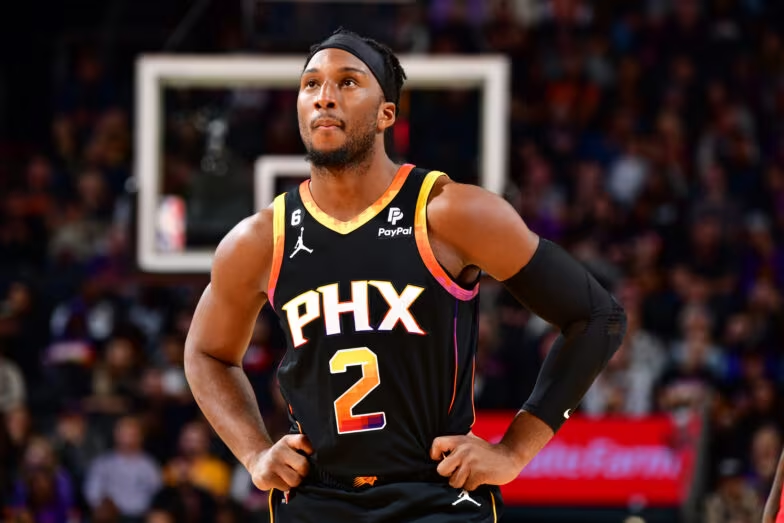

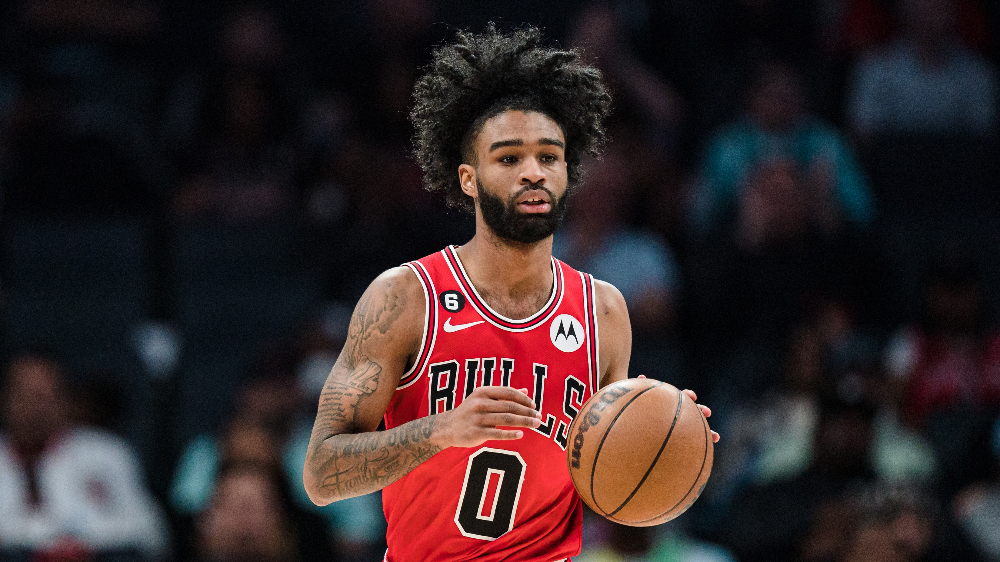

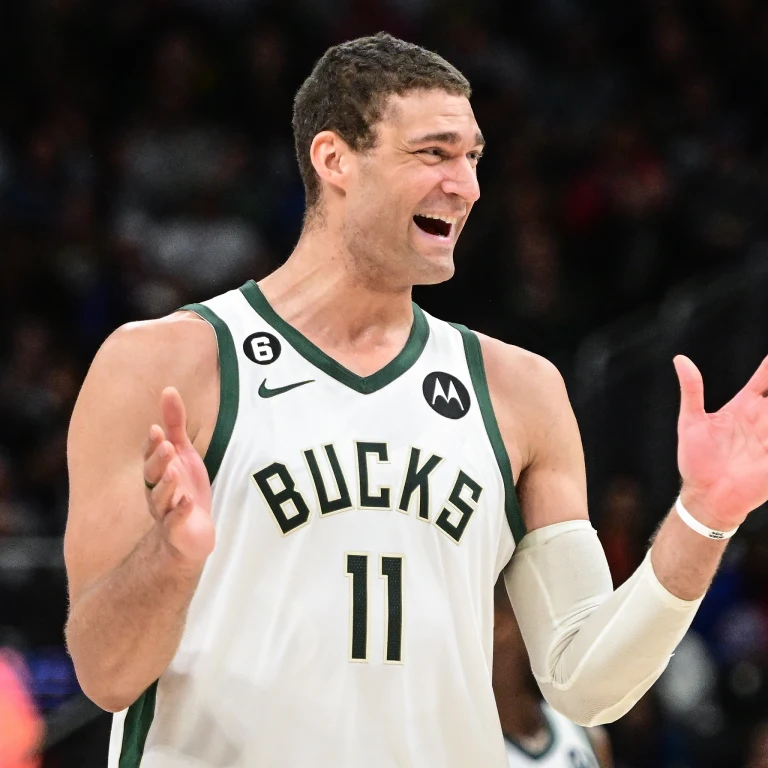